Author: Nicolas Legrand <nicolas.legrand@cfin.au.dk>

In [1]:
import numpy as np
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from systole.detection import oxi_peaks, rr_artefacts
from systole.correction import correct_rr
from systole.utils import heart_rate
from systole.hrv import time_domain, frequency_domain, nonlinear
from systole.interactive import plot_raw
import pingouin as pg

In [2]:
parent = os.path.join(os.getcwd(), os.pardir)
path = os.path.join(os.path.abspath(parent), 'Data', 'Raw')
subjects = [f for f in os.listdir(path) if len(f) == 5]
filename = path + '/{nSub}/{nSub}_Aro_{arousal}_Val_{valence}_Learn_{learningTime}_Block_{block}.txt'  # Template for signal files

# Pulse rate variability

In [3]:
final_df = pd.DataFrame([])
for nSub in subjects:
    
    # Import behavioural data
    df = pd.read_csv(os.path.join(path, nSub, 'Subject_{}.txt'.format(nSub)), na_values=['Nan'])

    # Loop through conditions
    fig, axs = plt.subplots(6, 2, figsize=[14, 14])
    axs, i = axs.ravel(), 0
    for val in ['High', 'Low']:
        for aro in ['High', 'Low']:

            for learningTime in [30, 60, 90]:

                # Filter for condition
                this_df = df.copy()[(df.Arousal == aro) & (df.Valence == val) & (df.LearningTime == learningTime)]
                nBlock = this_df.nBlock.iloc[0]  # Get block numbers
                
                # Import pulse oximeter recording
                signal_file = filename.format(nSub=nSub, arousal=aro, valence=val, learningTime=learningTime, block=int(nBlock))
                signal_df = pd.read_csv(signal_file)

                # Find peaks - Remove learning phase
                signal, peaks = oxi_peaks(signal_df.signal[np.where(np.asarray(signal_df.triggers)==2)[0][0]:], noise_removal=False)

                # Convert to RR time series
                rr = np.diff(np.where(peaks)[0])

                # Artifacts removal
                artefacts_correction = correct_rr(rr)

                percent_corrected = round(sum([artefacts_correction[i] for i in ['ectopic', 'long', 'short', 'missed', 'extra']])/len(rr), 4)
                clean_rr = artefacts_correction['clean_rr']

                # Plot RR
                axs[i].plot(np.cumsum(clean_rr)/1000, clean_rr, 'k-')
                axs[i].plot(np.cumsum(clean_rr)/1000, clean_rr, 'wo', markersize=4, markeredgecolor='k')
                axs[i].set_ylim(400, 1200)
                axs[i].set_xlabel('Time (s)')
                axs[i].text(100, 1100, 'Subject: ' + nSub + ', Valence:' + val + ' Arousal: ' + aro + 'Time: ' + str(learningTime))
                
                i += 1

                # HRV indexes
                hrv_time = time_domain(clean_rr)
                hrv_frequency = frequency_domain(clean_rr)
                hrv_nonlinear = nonlinear(clean_rr)

                this_df = hrv_time.append([hrv_frequency, hrv_nonlinear], ignore_index=True)
                this_df['Subject'] = nSub
                this_df['Valence'] = val
                this_df['Arousal'] = aro
                this_df['LearningTime'] = learningTime
                this_df['PercentCorrect'] = percent_corrected
                this_df['Signal_STD'] = signal.std()

                final_df = final_df.append(this_df, sort=False)
    
    plt.tight_layout()

    dirName = os.path.join(os.path.abspath(parent), 'Reports', 'R-R-TimeSeries')
    if not os.path.exists(dirName):
        os.mkdir(dirName)
    plt.savefig(dirName + nSub + '_CleaningRR.png', dpi=300)
    plt.close(fig)

# Rejection

**Drop participants due to bad signal**

In [4]:
reject = ['11141', '11137']

# Create reject vector
final_df['Reject'] = 0
for sub in reject:
    final_df.loc[final_df.Subject == sub, 'Reject'] = 1

In [5]:
# Reject bad segmaents
bads = [['11124', 'High', 'Low', 90],
        ['47617', 'High', 'Low', 30]]

for bad in bads:
    final_df.loc[(final_df.Subject == bad[0]) & (final_df.Valence == bad[1]) & (final_df.Arousal == bad[2]) & (final_df.Subject == bad[3]), 'Reject'] = 1

In [6]:
# Average across learning time
final_df = final_df.groupby(['Subject', 'Valence', 'Arousal', 'Metric'], as_index=False).mean()

In [7]:
final_df.to_csv(os.path.join(os.path.abspath(parent), 'Data', 'Preprocessed', 'hrv.txt'))

In [8]:
final_df = pd.read_csv(os.path.join(os.path.abspath(parent), 'Data', 'Preprocessed', 'hrv.txt'))

# Plot

In [9]:
final_df = final_df[final_df.Reject!=1]

In [20]:
# Rename factor level
final_df.loc[final_df.Metric=='pover_hf_nu', ['Metric']] = 'HF-HRV'
final_df.loc[final_df.Metric=='MeanBPM', ['Metric']] = 'Average BPM'

In [32]:
this_df = final_df[(final_df.Metric=='Average BPM')].groupby(['Subject', 'Valence', 'Arousal'], as_index=False).mean()

In [33]:
this_df2 = this_df[(this_df.Valence == 'High')]

In [34]:
this_df2.loc[:, 'Difference'] = this_df[(this_df.Valence == 'High')]['Values'].values - this_df[(this_df.Valence == 'Low')]['Values'].values

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


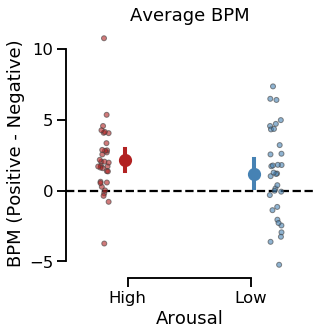

In [43]:
sns.set_context('talk')
fig, axs = plt.subplots(1, 1, figsize=(5, 5))
plt.axhline(y=0, linestyle='--', color='k')
sns.stripplot(data=this_df2, x='Arousal', y='Difference', hue='Arousal', ax=axs, palette=['firebrick', 'steelblue'], linewidth=1, dodge=True, alpha=.6)
sns.pointplot(data=this_df2, x='Arousal', y='Difference', hue='Arousal', ax=axs, palette=['firebrick', 'steelblue'], dodge=True)
#sns.boxplot(data=this_df2, x='Arousal', y='Difference', hue='Arousal', ax=axs, palette=['firebrick', 'steelblue'], dodge=True)
axs.set_title('Average BPM')
axs.set_ylabel('BPM (Positive - Negative)')
axs.get_legend().remove()
plt.tight_layout()
sns.despine(trim=10)
plt.savefig('diffplot.png', dpi=300)

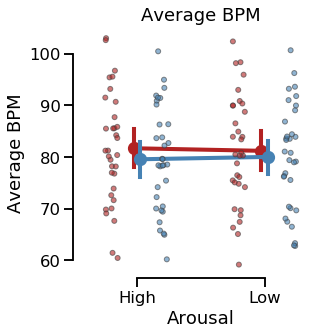

In [42]:
sns.set_context('talk')
fig, axs = plt.subplots(1, 1, figsize=(5, 5))

this_df = final_df[(final_df.Metric=='Average BPM')].groupby(['Subject', 'Valence', 'Arousal'], as_index=False).mean()

sns.stripplot(data=this_df, x='Arousal', y='Values', hue='Valence', ax=axs, palette=['firebrick', 'steelblue'], linewidth=1, dodge=True, alpha=.6)
sns.pointplot(data=this_df, x='Arousal', y='Values', hue='Valence', ax=axs, palette=['firebrick', 'steelblue'], dodge=True)
axs.set_title('Average BPM')
axs.set_ylabel('Average BPM')
axs.get_legend().remove()
plt.tight_layout()
sns.despine(trim=10)
plt.savefig('stripplot.png', dpi=300)

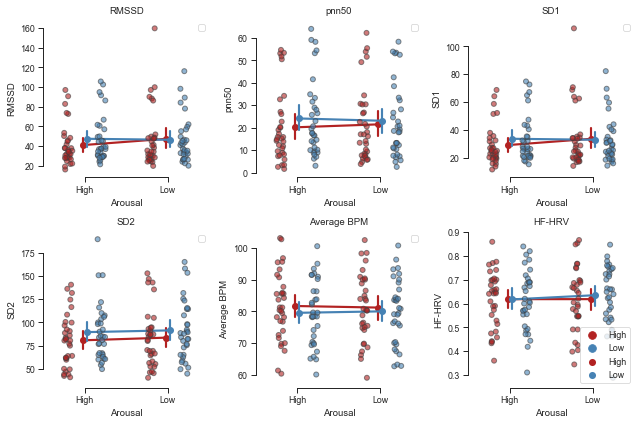

In [10]:
sns.set_context('paper')
fig, axs = plt.subplots(2, 3, figsize=(9, 6))
axs = axs.ravel()
aov, posthoc = [], []
for i, metric in enumerate(['RMSSD', 'pnn50', 'SD1', 'SD2', 'Average BPM', 'HF-HRV']):
    this_df = final_df[(final_df.Metric==metric)].groupby(['Subject', 'Valence', 'Arousal'], as_index=False).mean()

    aov.append(pg.rm_anova(data=this_df, subject='Subject', within=['Valence', 'Arousal'], dv='Values'))
    posthoc.append(pg.pairwise_ttests(data=this_df, subject='Subject', within=['Arousal', 'Valence'], dv='Values', effsize='cohen'))

    sns.stripplot(data=this_df, x='Arousal', y='Values', hue='Valence', ax=axs[i], palette=['firebrick', 'steelblue'], linewidth=1, dodge=True, alpha=.6)
    sns.pointplot(data=this_df, x='Arousal', y='Values', hue='Valence', ax=axs[i], palette=['firebrick', 'steelblue'], dodge=True)
    axs[i].set_title(metric)
    axs[i].set_ylabel(metric)
    axs[i].legend([])
plt.legend(loc='best')
plt.tight_layout()
sns.despine(trim=10)
dirName = os.path.join(os.getcwd(), 'Figures/')
plt.savefig(dirName + '/HRV.svg', dpi=300)

# Statistics

## RMSSD

In [11]:
aov[0]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,245.636,1,32,245.636,3.125,0.086650,0.086650,0.089,1.0
1,Arousal,239.007,1,32,239.007,1.822,0.186561,0.186561,0.054,1.0
2,Valence * Arousal,448.594,1,32,448.594,3.655,0.064882,0.064882,0.103,1.0


In [12]:
posthoc[0]

,Contrast,Arousal,A,B,Paired,Parametric,T,dof,Tail,p-unc,BF10,cohen
0,Arousal,-,High,Low,True,True,-1.350,32.0,two-sided,0.186561,0.426,-0.114
1,Valence,-,High,Low,True,True,-1.768,32.0,two-sided,0.086650,0.75,-0.117
2,Arousal * Valence,High,High,Low,True,True,-4.913,32.0,two-sided,0.000026,880.57,-0.290
3,Arousal * Valence,Low,High,Low,True,True,0.296,32.0,two-sided,0.769225,0.194,0.036


## pnn50

In [26]:
aov[1]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,253.797,1,32,253.797,28.960,0.000007,0.000007,0.475,1.0
1,Arousal,0.695,1,32,0.695,0.100,0.753820,0.753820,0.003,1.0
2,Valence * Arousal,45.213,1,32,45.213,4.971,0.032923,0.032923,0.134,1.0


In [27]:
posthoc[1]

,Contrast,Arousal,A,B,Paired,Parametric,T,dof,Tail,p-unc,BF10,cohen
0,Arousal,-,High,Low,True,True,-0.316,32.0,two-sided,7.538201e-01,0.195,-0.009
1,Valence,-,High,Low,True,True,-5.381,32.0,two-sided,6.548711e-06,3071.324,-0.168
2,Arousal * Valence,High,High,Low,True,True,-6.634,32.0,two-sided,1.756680e-07,8.824e+04,-0.237
3,Arousal * Valence,Low,High,Low,True,True,-1.877,32.0,two-sided,6.963406e-02,0.888,-0.097


## SD1

In [28]:
aov[2]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,123.292,1,32,123.292,3.126,0.086572,0.086572,0.089,1.0
1,Arousal,119.907,1,32,119.907,1.822,0.186541,0.186541,0.054,1.0
2,Valence * Arousal,225.146,1,32,225.146,3.657,0.064804,0.064804,0.103,1.0


In [29]:
posthoc[2]

,Contrast,Arousal,A,B,Paired,Parametric,T,dof,Tail,p-unc,BF10,cohen
0,Arousal,-,High,Low,True,True,-1.350,32.0,two-sided,0.186541,0.426,-0.114
1,Valence,-,High,Low,True,True,-1.768,32.0,two-sided,0.086572,0.75,-0.117
2,Arousal * Valence,High,High,Low,True,True,-4.916,32.0,two-sided,0.000025,885.313,-0.290
3,Arousal * Valence,Low,High,Low,True,True,0.296,32.0,two-sided,0.769190,0.194,0.036


## SD2

In [30]:
aov[3]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,2297.826,1,32,2297.826,22.788,0.000038,0.000038,0.416,1.0
1,Arousal,186.010,1,32,186.010,1.543,0.223210,0.223210,0.046,1.0
2,Valence * Arousal,8.314,1,32,8.314,0.064,0.802058,0.802058,0.002,1.0


## BPM

In [32]:
aov[4]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,90.780,1,32,90.780,15.644,0.000397,0.000397,0.328,1.0
1,Arousal,0.015,1,32,0.015,0.009,0.926212,0.926212,0.000,1.0
2,Valence * Arousal,7.517,1,32,7.517,3.775,0.060857,0.060857,0.106,1.0


## HF-HRV

In [24]:
aov[5]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,0.002,1,32,0.002,0.550,0.463609,0.463609,0.017,1.0
1,Arousal,0.003,1,32,0.003,1.193,0.282825,0.282825,0.036,1.0
2,Valence * Arousal,0.003,1,32,0.003,1.060,0.311041,0.311041,0.032,1.0


# Signal visualization

In [60]:
this_df = final_df[(final_df.Metric=='SD1')].groupby(['Subject', 'Valence', 'Arousal'], as_index=False).mean()
this_df[this_df.Values>50]

,Subject,Valence,Arousal,Unnamed: 0,Values,LearningTime,PercentCorrect,Signal_STD,Reject
8,11115,High,High,23,68.743800,60,0.013667,73.199940,0
9,11115,High,Low,23,62.579283,60,0.012233,68.852702,0
10,11115,Low,High,23,72.669001,60,0.004900,64.058927,0
11,11115,Low,Low,23,69.598047,60,0.007767,72.845406,0
16,11117,High,High,23,58.723875,60,0.029267,62.077180,0
17,11117,High,Low,23,61.109573,60,0.022033,59.452520,0
18,11117,Low,High,23,64.921738,60,0.015833,40.252222,0
19,11117,Low,Low,23,59.643951,60,0.014867,51.186449,0
28,11121,High,High,23,51.507985,60,0.006967,29.293181,0
29,11121,High,Low,23,63.816960,60,0.022567,27.472901,0


In [61]:
nSub = '11115'
val, aro, learningTime = 'Low', 'High', 60
    
# Import behavioural data
df = pd.read_csv(os.path.join(path, nSub, 'Subject_{}.txt'.format(nSub)), na_values=['Nan'])

# Filter for condition
this_df = df.copy()[(df.Arousal == aro) & (df.Valence == val) & (df.LearningTime == learningTime)]
nBlock = this_df.nBlock.iloc[0]  # Get block numbers

# Import pulse oximeter recording
signal_file = filename.format(nSub=nSub, arousal=aro, valence=val, learningTime=learningTime, block=int(nBlock))
signal_df = pd.read_csv(signal_file)

Start extracting data from subject11115


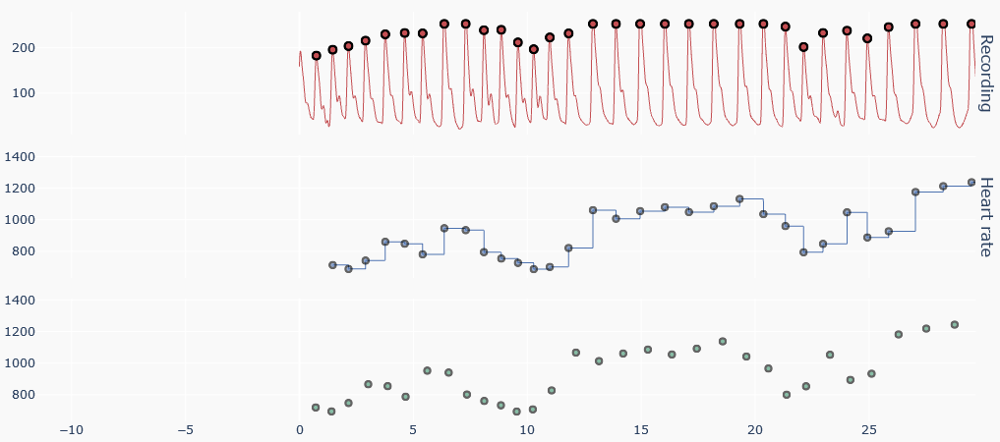

In [62]:
plot_raw(signal_df)